In [1]:
import pandas as pd

# Load the training dataset
train = pd.read_csv('Corona_NLP_train.csv', encoding='latin1')

# Load the test dataset
test = pd.read_csv('Corona_NLP_test.csv', encoding='latin1')

In [2]:
print(train)

       UserName  ScreenName                      Location     TweetAt  \
0          3799       48751                        London  16-03-2020   
1          3800       48752                            UK  16-03-2020   
2          3801       48753                     Vagabonds  16-03-2020   
3          3802       48754                           NaN  16-03-2020   
4          3803       48755                           NaN  16-03-2020   
...         ...         ...                           ...         ...   
41152     44951       89903  Wellington City, New Zealand  14-04-2020   
41153     44952       89904                           NaN  14-04-2020   
41154     44953       89905                           NaN  14-04-2020   
41155     44954       89906                           NaN  14-04-2020   
41156     44955       89907  i love you so much || he/him  14-04-2020   

                                           OriginalTweet           Sentiment  
0      @MeNyrbie @Phil_Gahan @Chrisitv https

In [3]:
print(test)

      UserName  ScreenName             Location     TweetAt  \
0            1       44953                  NYC  02-03-2020   
1            2       44954          Seattle, WA  02-03-2020   
2            3       44955                  NaN  02-03-2020   
3            4       44956          Chicagoland  02-03-2020   
4            5       44957  Melbourne, Victoria  03-03-2020   
...        ...         ...                  ...         ...   
3793      3794       48746            Israel ??  16-03-2020   
3794      3795       48747       Farmington, NM  16-03-2020   
3795      3796       48748        Haverford, PA  16-03-2020   
3796      3797       48749                  NaN  16-03-2020   
3797      3798       48750  Arlington, Virginia  16-03-2020   

                                          OriginalTweet           Sentiment  
0     TRENDING: New Yorkers encounter empty supermar...  Extremely Negative  
1     When I couldn't find hand sanitizer at Fred Me...            Positive  
2     Fin

**1. Concatenate the following three columns into a new column of Tweet_texts:
Location
TweetAt
OriginalTweet**

In [4]:
# Concatenate the specified columns into a new column 'Tweet_texts' for both datasets
train['Tweet_texts'] = train['Location'].astype(str) + ' ' + train['TweetAt'].astype(str) + ' ' + train['OriginalTweet'].astype(str)
test['Tweet_texts'] = test['Location'].astype(str) + ' ' + test['TweetAt'].astype(str) + ' ' + test['OriginalTweet'].astype(str)

# Display the updated dataframes
print("Training Dataset with Concatenated Tweet_texts:")
print(train[['Location', 'TweetAt', 'OriginalTweet', 'Tweet_texts']].head())

print("\nTest Dataset with Concatenated Tweet_texts:")
print(test[['Location', 'TweetAt', 'OriginalTweet', 'Tweet_texts']].head())


Training Dataset with Concatenated Tweet_texts:
    Location     TweetAt                                      OriginalTweet  \
0     London  16-03-2020  @MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...   
1         UK  16-03-2020  advice Talk to your neighbours family to excha...   
2  Vagabonds  16-03-2020  Coronavirus Australia: Woolworths to give elde...   
3        NaN  16-03-2020  My food stock is not the only one which is emp...   
4        NaN  16-03-2020  Me, ready to go at supermarket during the #COV...   

                                         Tweet_texts  
0  London 16-03-2020 @MeNyrbie @Phil_Gahan @Chris...  
1  UK 16-03-2020 advice Talk to your neighbours f...  
2  Vagabonds 16-03-2020 Coronavirus Australia: Wo...  
3  nan 16-03-2020 My food stock is not the only o...  
4  nan 16-03-2020 Me, ready to go at supermarket ...  

Test Dataset with Concatenated Tweet_texts:
              Location     TweetAt  \
0                  NYC  02-03-2020   
1          Seattle, WA  02

**2. Clean and preprocess the new column of Tweet_texts:**
* 2.1 Remove all special characters, punctuation using a regular expression.
* 2.2 Remove the date and time in the tweets using a regular expression.
* 2.3 Remove the hyperlink URL in the tweets using a regular expression.
* 2.4 Remove the Twitter hashtags(# before a relevant keyword or phrase ) in the tweets using a regular expression.
* 2.5 Remove the usernames (also known as the handle –– begins with the “@” symbol) using a regular expression.
* 2.6 Remove all words containing at most two characters such as "a", "an", "in", "on", etc.
* 2.7 Remove all rows without any text left (empty text) in the column of Tweet_texts.

In [5]:
import pandas as pd
import re
import spacy
from spacy.lang.en.stop_words import STOP_WORDS

# Load the spaCy English language model
nlp = spacy.load('en_core_web_sm')

# Function to clean and preprocess text
def preprocess_text(text):
    # Remove special characters and punctuation
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    
    # Remove date and time
    text = re.sub(r'\b\d{1,2}/\d{1,2}/\d{4}\b', '', text)
    text = re.sub(r'\b\d{1,2}:\d{1,2}\b', '', text)
    
    # Remove hyperlinks
    text = re.sub(r'http\S+', '', text)
    
    # Remove Twitter hashtags
    text = re.sub(r'#\w+', '', text)
    
    # Remove usernames (handles starting with "@")
    text = re.sub(r'@\w+', '', text)
    
    # Remove words with at most two characters
    text = ' '.join([word for word in text.split() if len(word) > 2])
    
    # Remove stop words
    doc = nlp(text)
    tokens_without_stop = [token.text for token in doc if token.text.lower() not in STOP_WORDS]
    
    return ' '.join(tokens_without_stop)

# Apply the preprocessing function to the 'Tweet_texts' column in both train and test datasets
train['Tweet_texts_cleaned'] = train['Tweet_texts'].apply(preprocess_text)

# Remove rows without any text left (empty text)
train = train[train['Tweet_texts_cleaned'] != '']

# Display the updated dataframes
print("Training Dataset after Text Preprocessing:")
print(train[['Tweet_texts_cleaned', 'Sentiment']].head())


Training Dataset after Text Preprocessing:
                                 Tweet_texts_cleaned           Sentiment
0                 London MeNyrbie PhilGahan Chrisitv             Neutral
1  advice Talk neighbours family exchange phone n...            Positive
2  Vagabonds Coronavirus Australia Woolworths eld...            Positive
3  nan food stock nt panic FOOD need Stay calm st...            Positive
4  nan ready supermarket COVID outbreak paranoid ...  Extremely Negative


**2.8 Perform the part of speech tagging for the texts.(with NLTK)**

In [6]:
import nltk
from nltk import pos_tag
from nltk.tokenize import word_tokenize

# Download NLTK data (if not already downloaded)
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

# Function to perform part-of-speech tagging
def pos_tagging(text):
    words = word_tokenize(text)
    pos_tags = pos_tag(words)
    return pos_tags


# Apply part-of-speech tagging to the 'Tweet_texts' column
train['POS_tags'] = train['Tweet_texts_cleaned'].apply(pos_tagging)

# Display the updated dataframe with POS tags
print("Training Dataset with POS Tags:")
print(train[['Tweet_texts_cleaned', 'POS_tags', 'Sentiment']].head())


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\surya\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\surya\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


Training Dataset with POS Tags:
                                 Tweet_texts_cleaned  \
0                 London MeNyrbie PhilGahan Chrisitv   
1  advice Talk neighbours family exchange phone n...   
2  Vagabonds Coronavirus Australia Woolworths eld...   
3  nan food stock nt panic FOOD need Stay calm st...   
4  nan ready supermarket COVID outbreak paranoid ...   

                                            POS_tags           Sentiment  
0  [(London, NNP), (MeNyrbie, NNP), (PhilGahan, N...             Neutral  
1  [(advice, NN), (Talk, NN), (neighbours, IN), (...            Positive  
2  [(Vagabonds, NNS), (Coronavirus, NNP), (Austra...            Positive  
3  [(nan, RB), (food, NN), (stock, NN), (nt, NN),...            Positive  
4  [(nan, RB), (ready, JJ), (supermarket, NN), (C...  Extremely Negative  


**2.8 Perform the part of speech tagging for the texts.(with SpaCy)**

In [7]:
# Function to perform part-of-speech tagging with spaCy
def pos_tagging_spacy(text):
    doc = nlp(text)
    pos_tags = [(token.text, token.pos_) for token in doc]
    return pos_tags

# Apply part-of-speech tagging with spaCy to the 'Tweet_texts' column
train['POS_tags_spacy'] = train['Tweet_texts_cleaned'].apply(pos_tagging_spacy)

# Display the updated dataframe with spaCy POS tags
print("Training Dataset with spaCy POS Tags:")
print(train[['Tweet_texts_cleaned', 'POS_tags_spacy', 'Sentiment']].head())


Training Dataset with spaCy POS Tags:
                                 Tweet_texts_cleaned  \
0                 London MeNyrbie PhilGahan Chrisitv   
1  advice Talk neighbours family exchange phone n...   
2  Vagabonds Coronavirus Australia Woolworths eld...   
3  nan food stock nt panic FOOD need Stay calm st...   
4  nan ready supermarket COVID outbreak paranoid ...   

                                      POS_tags_spacy           Sentiment  
0  [(London, PROPN), (MeNyrbie, PROPN), (PhilGaha...             Neutral  
1  [(advice, NOUN), (Talk, PROPN), (neighbours, P...            Positive  
2  [(Vagabonds, PROPN), (Coronavirus, PROPN), (Au...            Positive  
3  [(nan, PROPN), (food, PROPN), (stock, PROPN), ...            Positive  
4  [(nan, PROPN), (ready, ADJ), (supermarket, NOU...  Extremely Negative  


**2.9 Visualize the dependency parser.**

In [8]:
from spacy import displacy

# Function to visualize dependency parser with spaCy
def visualize_dependency_parser(text):
    doc = nlp(text)
    displacy.render(doc, style='dep', jupyter=True, options={'distance': 90})

# Choose a sample tweet for visualization
sample_tweet = train['Tweet_texts_cleaned'].iloc[1]

# Visualize the dependency parser for the sample tweet
visualize_dependency_parser(sample_tweet)

**2.10 Perform the named entities recognition for the texts.**

In [9]:
# Function to perform named entity recognition with spaCy
def named_entity_recognition(text):
    doc = nlp(text)
    entities = [(ent.text, ent.label_) for ent in doc.ents]
    return entities

# Apply named entity recognition with spaCy to the 'Tweet_texts' column
train['Named_Entities'] = train['Tweet_texts_cleaned'].apply(named_entity_recognition)

# Display the updated dataframe with named entities
print("Training Dataset with Named Entities:")
print(train[['Tweet_texts_cleaned', 'Named_Entities', 'Sentiment']].head())


Training Dataset with Named Entities:
                                 Tweet_texts_cleaned  \
0                 London MeNyrbie PhilGahan Chrisitv   
1  advice Talk neighbours family exchange phone n...   
2  Vagabonds Coronavirus Australia Woolworths eld...   
3  nan food stock nt panic FOOD need Stay calm st...   
4  nan ready supermarket COVID outbreak paranoid ...   

                                      Named_Entities           Sentiment  
0      [(London, GPE), (PhilGahan Chrisitv, PERSON)]             Neutral  
1                                                 []            Positive  
2   [(Vagabonds Coronavirus, PERSON), (hours, TIME)]            Positive  
3  [(nan food stock nt panic FOOD, ORG), (Confine...            Positive  
4                                     [(COVID, ORG)]  Extremely Negative  


In [10]:
# Concatenate all preprocessed texts into a single text string
all_text_combined = ' '.join(train['Tweet_texts_cleaned'])

# Display the combined text
print("Combined Text:")
print(all_text_combined[:500])

Combined Text:
London MeNyrbie PhilGahan Chrisitv advice Talk neighbours family exchange phone numbers create contact list phone numbers neighbours schools employer chemist set online shopping accounts poss adequate supplies regular meds order Vagabonds Coronavirus Australia Woolworths elderly disabled dedicated shopping hours amid COVID outbreak nan food stock nt panic FOOD need Stay calm stay safe COVIDfrance COVID COVID coronavirus confinement Confinementotal ConfinementGeneral nan ready supermarket COVID o


**2.11 Visualize the GEOLOCATION, MONEY, and QUANTITY in the texts.**

In [11]:
# Limit the length to the first 1000 words
limited_text = ' '.join(all_text_combined.split()[:1000])

# Process the limited text with spaCy
doc = nlp(limited_text)

# Extract named entities for specific types (GEOLOCATION, MONEY, QUANTITY)
selected_entities = [(ent.text, ent.label_) for ent in doc.ents if ent.label_ in ['GPE', 'MONEY', 'QUANTITY']]

# Visualize the named entities
options = {"ents": ['GPE', 'MONEY', 'QUANTITY'],
           "colors": {'GPE': '#FFD700', 'MONEY': '#82E0AA', 'QUANTITY': '#ADD8E6'}}
displacy.render(doc, style="ent", jupyter=True, options=options)

# Display the selected entities
print("Selected Entities:")
print(selected_entities)

Selected Entities:
[('London', 'GPE'), ('Sullivan County week', 'GPE'), ('Austria', 'GPE'), ('Atlanta', 'GPE'), ('Philippines', 'GPE'), ('Chicago', 'GPE'), ('Saudi Arabia', 'GPE'), ('Russia', 'GPE'), ('Iran', 'GPE'), ('Denver', 'GPE'), ('china', 'GPE'), ('London', 'GPE'), ('Idaho', 'GPE'), ('New York', 'GPE'), ('Corona', 'GPE'), ('Canada', 'GPE'), ('United States', 'GPE'), ('Fort Worth', 'GPE'), ('Texas', 'GPE'), ('USA', 'GPE'), ('houston', 'GPE'), ('Washington', 'GPE'), ('Washington', 'GPE')]


**3. Extract all the tokens from the Tweet_texts.**

In [12]:
# Extract tokens from the processed text
tokens = [token.text for token in doc]

# Display the first few tokens as an example
print("Tokens:")
print(tokens[:10])  

Tokens:
['London', 'MeNyrbie', 'PhilGahan', 'Chrisitv', 'advice', 'Talk', 'neighbours', 'family', 'exchange', 'phone']


**4. Replace the Tweet_texts column with the string only containing the lemmas of all the tokens.**

In [13]:
# Function to preprocess and lemmatize text
def lemmatize(text):
    
    doc = nlp(text)
    tokens_without_stop = [token.lemma_ for token in doc if token.text.lower() not in STOP_WORDS]
    
    return ' '.join(tokens_without_stop)

# Assuming 'train' is the DataFrame that has already been loaded and preprocessed
train['Tweet_texts_lemmas'] = train['Tweet_texts_cleaned'].apply(lemmatize)

# Remove rows without any text left (empty text)
train = train[train['Tweet_texts_lemmas'] != '']

# Display the updated DataFrame
print("Updated DataFrame with Lemmatized Text:")
print(train[['Tweet_texts_lemmas', 'Sentiment']].head())


Updated DataFrame with Lemmatized Text:
                                  Tweet_texts_lemmas           Sentiment
0                 London MeNyrbie PhilGahan Chrisitv             Neutral
1  advice Talk neighbours family exchange phone n...            Positive
2  Vagabonds Coronavirus Australia Woolworths eld...            Positive
3  nan food stock not panic food need stay calm s...            Positive
4  nan ready supermarket COVID outbreak paranoid ...  Extremely Negative


**5. Graphically summarize the Sentiment.**

In [14]:
train['Sentiment'].value_counts(normalize= True)

Positive              0.277550
Negative              0.240979
Neutral               0.187325
Extremely Positive    0.160960
Extremely Negative    0.133186
Name: Sentiment, dtype: float64

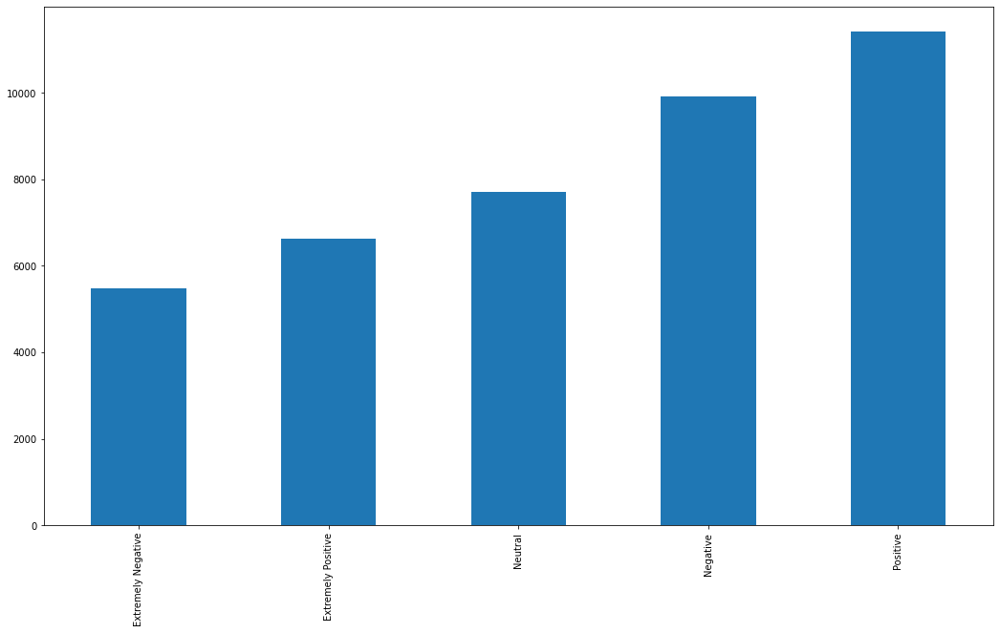

In [15]:
x = train.Sentiment.value_counts().sort_values().plot(kind = 'bar', figsize=(17.8,10))

**6. Graphically summarize the length of the text of the Tweet_texts using.**
* boxplot
* histogram
* density plot

In [16]:
train["len_text_bc"] = train['Tweet_texts'].str.len()
train["len_text_ac"] = train['Tweet_texts_lemmas'].str.len()
pd.options.display.float_format = "{:.2f}".format
train[["len_text_bc", "len_text_ac"]].describe()

,len_text_bc,len_text_ac
count,41153.00,41153.00
mean,228.13,130.46
std,69.30,45.08
min,27.00,3.00
25%,174.00,96.00
50%,239.00,134.00
75%,285.00,165.00
max,421.00,272.00


**Boxplot**

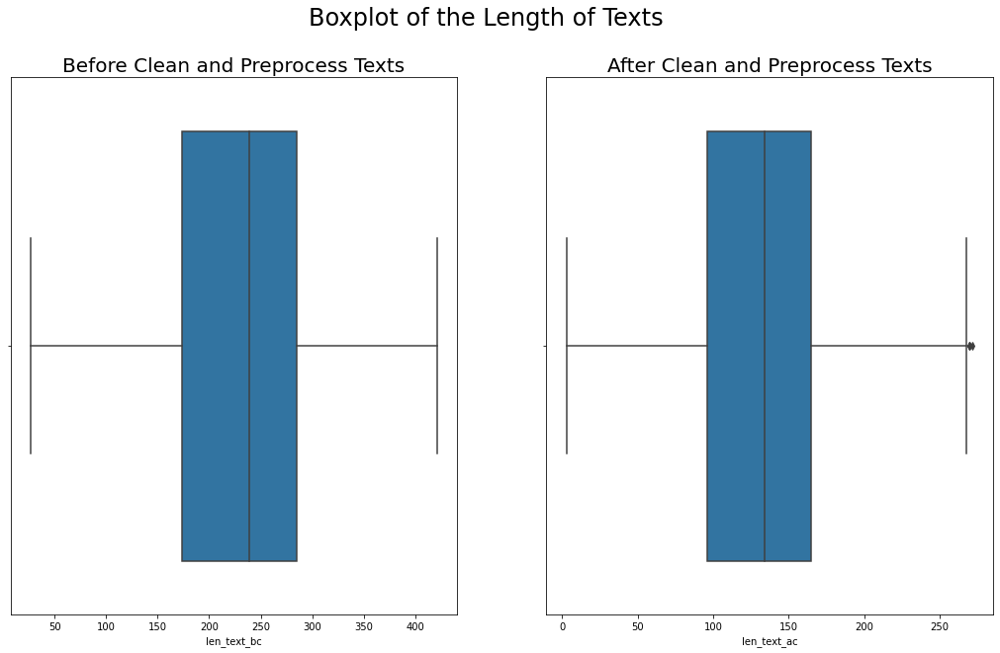

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Boxplot of the Length of Texts', fontsize= 24)

# Plot the texts before cleaning
sns.boxplot(ax=axes[0], x=train["len_text_bc"])
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)
# Plot the texts after cleaning
sns.boxplot(ax=axes[1], x=train["len_text_ac"])
x= axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)

**Histogram of the Length of the Texts**

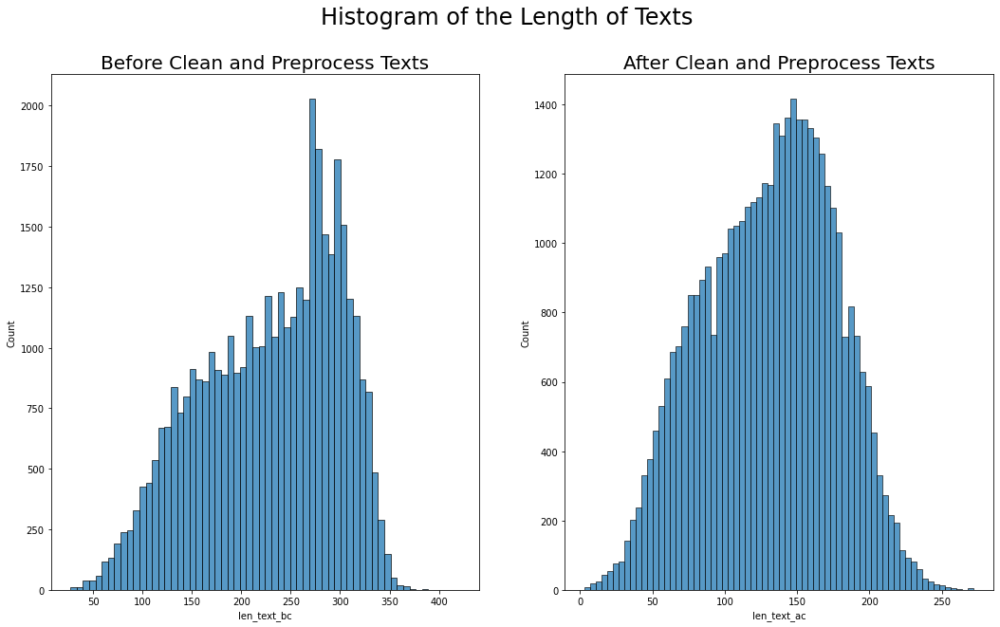

In [18]:
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Histogram of the Length of Texts', fontsize= 24)

# Plot the texts before cleaning
sns.histplot(ax=axes[0], data = train, x="len_text_bc")
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)
# Plot the texts after cleaning
sns.histplot(ax=axes[1], data = train, x="len_text_ac")
x= axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)


**Density plot of the Length of the Texts.**
* The area under the curve is the corresponding probablitity

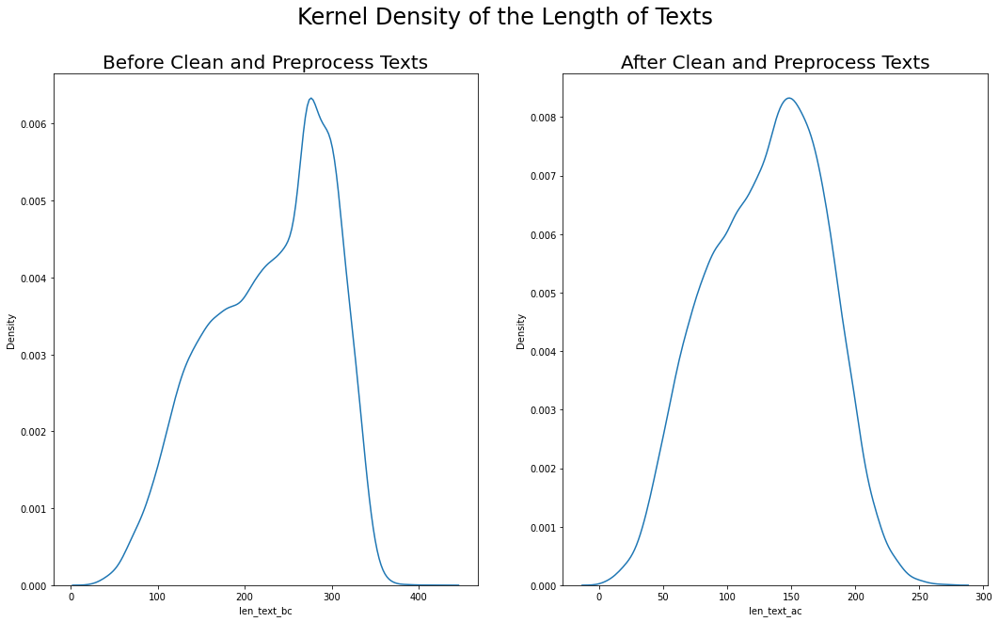

In [19]:
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Kernel Density of the Length of Texts', fontsize= 24)

sns.kdeplot(ax=axes[0], data = train, x="len_text_bc")
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)

sns.kdeplot(ax=axes[1], data = train, x="len_text_ac")
x= axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)

**7. Graphically summarize the word count of the text of the Tweet_texts using**
* boxplot
* histogram
* density plot

In [20]:
train["count_word_bc"] = train['Tweet_texts'].str.split().str.len()
train["count_word_ac"] = train['Tweet_texts_lemmas'].str.split().str.len()
train[["count_word_bc", "count_word_ac"]].describe()

,count_word_bc,count_word_ac
count,41153.00,41153.00
mean,33.46,17.87
std,11.65,6.04
min,3.00,1.00
25%,24.00,13.00
50%,35.00,18.00
75%,43.00,22.00
max,67.00,39.00


**Boxplot**

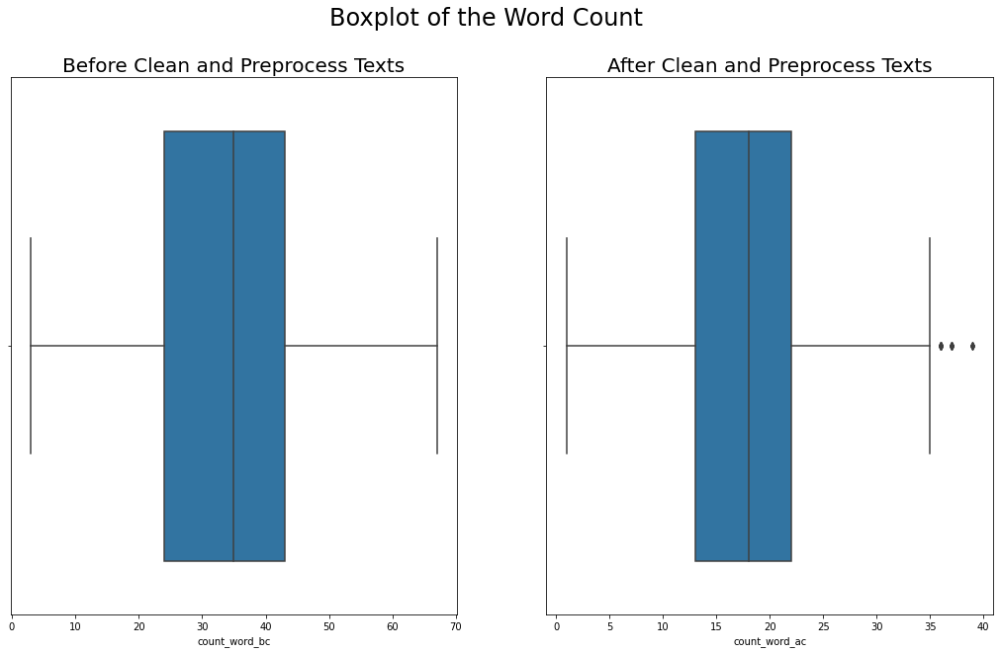

In [21]:
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Boxplot of the Word Count', fontsize= 24)

sns.boxplot(ax=axes[0], x=train["count_word_bc"])
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)

sns.boxplot(ax=axes[1], x=train["count_word_ac"])
x = axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)

**Histogram**

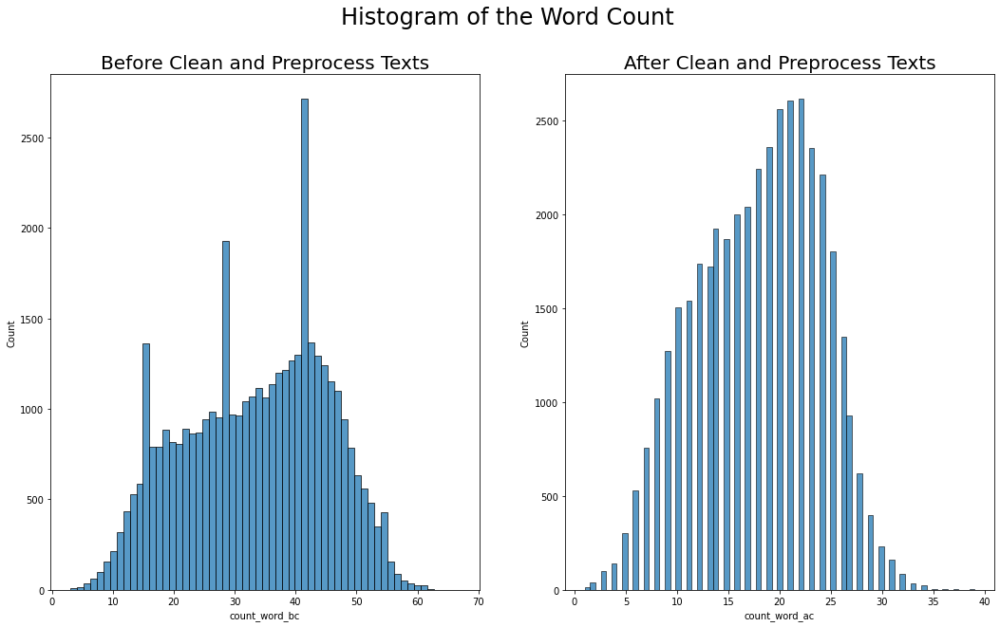

In [22]:
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Histogram of the Word Count', fontsize= 24)

sns.histplot(ax=axes[0], data = train, x="count_word_bc")
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)

sns.histplot(ax=axes[1], data = train, x="count_word_ac")
x= axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)

**Density Plot**

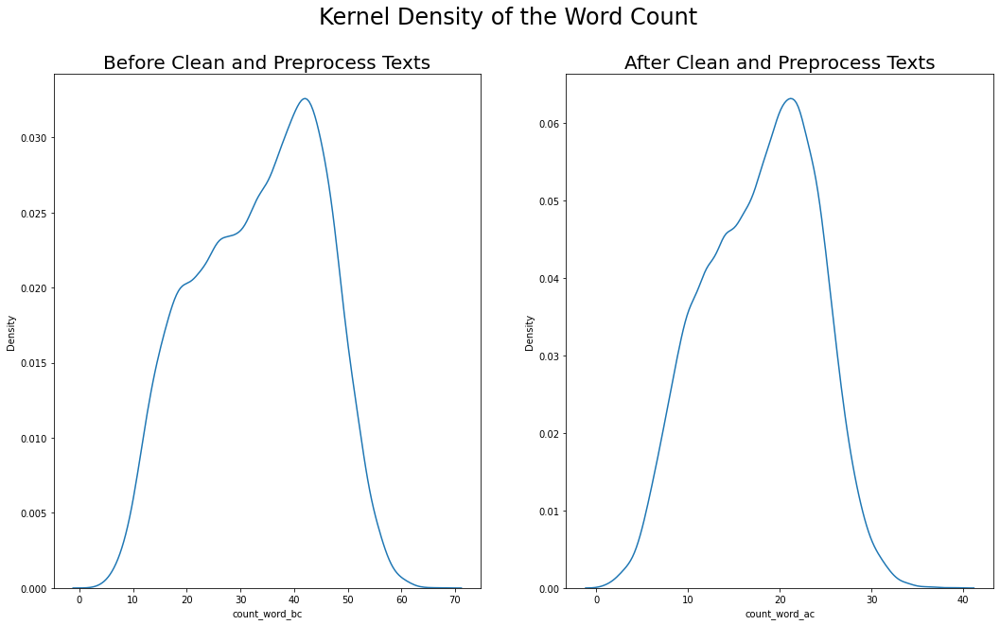

In [23]:
fig, axes = plt.subplots(1, 2, figsize = (17.8, 10))
fig.suptitle('Kernel Density of the Word Count', fontsize= 24)

sns.kdeplot(ax=axes[0], data = train, x="count_word_bc")
axes[0].set_title("Before Clean and Preprocess Texts", fontsize= 20)

sns.kdeplot(ax=axes[1], data = train, x="count_word_ac")
x= axes[1].set_title("After Clean and Preprocess Texts", fontsize= 20)


**8. Graphically summarize the top 10 unigram and bigrams of the tf-idf of the text of the Tweet_texts.**

In [24]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer

def get_top_tf_idf_words(df=train, col='Tweet_texts', use_idf=True, ngram_range=(1, 1), top_n=5):
    tf_idf = TfidfVectorizer(stop_words='english', ngram_range=ngram_range, use_idf=use_idf)
    
    # Fit and transform the corpus
    X_sparse_matrix = tf_idf.fit_transform(df[col])
    
    # Get feature names from the vocabulary
    feature_names = np.array(tf_idf.get_feature_names())
    
    # Generate the tf-idf matrix
    tf_idf_sparse_matrix = tf_idf.transform(df[col])
    
    # Rank the matrix by tf-idf values and return the indices of the top_n values
    sorted_idx = np.argsort(tf_idf_sparse_matrix.data)[:-(top_n+1):-1]
    
    # Return the feature names and corresponding tf_idf values in a DataFrame
    return pd.DataFrame(
        {'feature': feature_names[tf_idf_sparse_matrix.indices[sorted_idx]],
         'tf_idf': tf_idf_sparse_matrix.data[sorted_idx],
        })

top_n = 10

# Generate top tf-idf words for the texts before and after cleaning
df_text_bc = get_top_tf_idf_words(df=train, col='Tweet_texts', top_n=top_n)
df_text_ac = get_top_tf_idf_words(df=train, col='Tweet_texts_lemmas', top_n=top_n)

# Display the DataFrames
print("Top TF-IDF Words Before Cleaning:")
print(df_text_bc)

print("\nTop TF-IDF Words After Cleaning:")
print(df_text_ac)


Top TF-IDF Words Before Cleaning:
              feature  tf_idf
0                pray    0.95
1             imhotep    0.91
2              tahini    0.90
3  pricelessaycalling    0.90
4             deeside    0.90
5            security    0.89
6                oman    0.89
7             cartoon    0.89
8          jjgggz6oxf    0.89
9               deals    0.88

Top TF-IDF Words After Cleaning:
       feature  tf_idf
0        nycla    1.00
1  supermarket    1.00
2          nan    1.00
3    ynetalert    1.00
4        goner    1.00
5          nan    1.00
6          nan    1.00
7         food    1.00
8      nhknews    1.00
9      cartoon    1.00


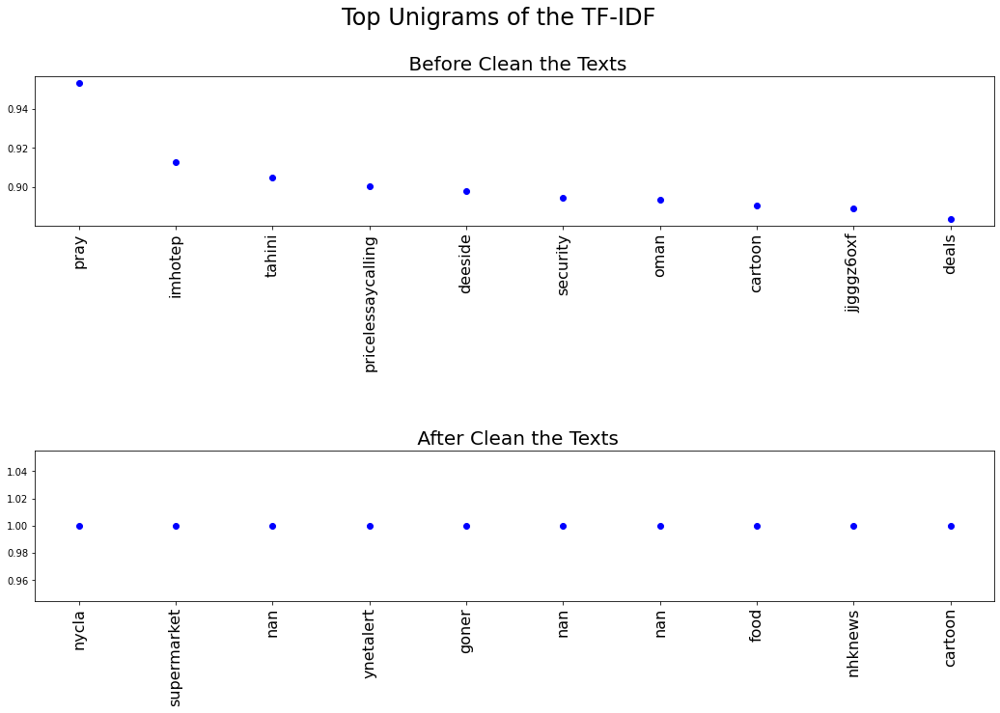

In [25]:
# x is from 0 to top_n-1; 0, 1, 2, ..., top_n-1
x=range(0, top_n)

fig, ax = plt.subplots(2, 1, figsize = (17.8, 10))

fig.suptitle('Top Unigrams of the TF-IDF', fontsize= 24)

# Plot x and tf_idf using blue circle markers
ax[0].plot(x, df_text_bc.tf_idf, 'bo')
ax[0].set_title(' Before Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[0].set_xticks(x)
# Set ticks labels for x-axis
x_ticks_labels = df_text_bc.feature
ax[0].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Plot x and tf_idf using blue circle markers
ax[1].plot(x, df_text_ac.tf_idf, 'bo')
ax[1].set_title(' After Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[1].set_xticks(x)
# Set ticks labels for x-axis instead of using 0, 1, 2, ..., 19
x_ticks_labels = df_text_ac.feature
# set the word vertically to use less horizontal spaces
ax[1].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Adjust horizontal space
fig.subplots_adjust(hspace=1.5)
plt.show()



**9. Visualize the top 10 term frequency of the tokens associated with positive tweets using scattertext.(Considered only Positive case of 5 cases. Ignored Extremely positive case)**

In [26]:
import scattertext as st
from pprint import pprint

# Generate corpus for the before cleaning texts
corpus_bc = st.CorpusFromPandas(train, 
                              category_col='Sentiment', 
                              text_col='Tweet_texts', # corresponding text columns
                              nlp=nlp).build()
# Generate corpus for the cleaned texts
corpus_ac = st.CorpusFromPandas(train, 
                              category_col='Sentiment', 
                              text_col='Tweet_texts_lemmas',
                              nlp=nlp).build()

In [27]:
# Create the term frequence for the sentiment before cleaning the texts
term_freq_df_bc = corpus_bc.get_term_freq_df()

term_freq_df_bc['positive Score'] = corpus_bc.get_scaled_f_scores('Positive')
# Rank them by descending order; note the by value  is 'positive freq'. It is combine the given 'positive' and the 'freq' choosen by the sc algorithm
term_freq_df_bc_freq = term_freq_df_bc.sort_values(by= 'Positive freq', ascending=False)
term_freq_df_bc_Score = term_freq_df_bc.sort_values(by= 'positive Score', ascending=False)

# Create the term frequence for the sentiment after cleaning the texts
term_freq_df_ac = corpus_ac.get_term_freq_df()
# Create the positive score for the sentiment of positive review after cleaning the texts
term_freq_df_ac['positive Score'] = corpus_ac.get_scaled_f_scores('Positive')
# Rank them by descending order
term_freq_df_ac_freq = term_freq_df_ac.sort_values(by= 'Positive freq', ascending=False)
term_freq_df_ac_Score = term_freq_df_ac.sort_values(by= 'positive Score', ascending=False)


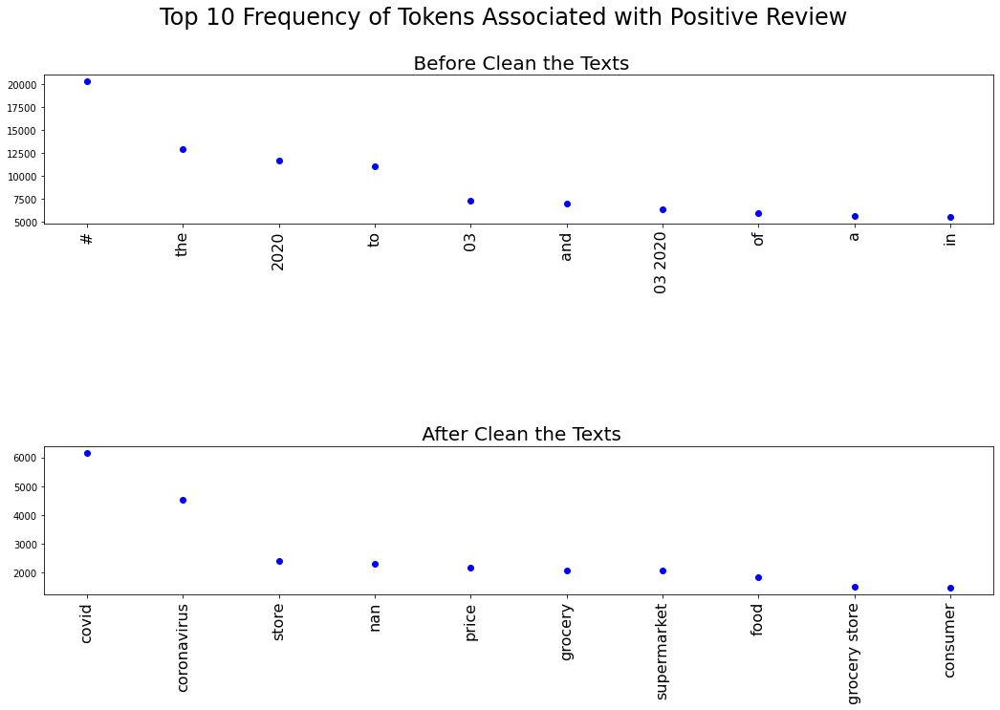

In [28]:
# Specify the top n tokens to plot
top_n = 10
term_freq_df_ac_freq = term_freq_df_ac_freq.head(top_n)
term_freq_df_bc_freq = term_freq_df_bc_freq.head(top_n)
x = range(0, top_n)

fig, ax = plt.subplots(2, 1, figsize = (17.8, 10))

fig.suptitle('Top 10 Frequency of Tokens Associated with Positive Review', fontsize= 24)

# Plot x and tf using blue circle markers
ax[0].plot(x, term_freq_df_bc_freq["Positive freq"], 'bo')
ax[0].set_title(' Before Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[0].set_xticks(x)
# Set ticks labels for x-axis to be the tokens which is the corresponding index
x_ticks_labels = term_freq_df_bc_freq.index
ax[0].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Plot x and tf using blue circle markers
ax[1].plot(x, term_freq_df_ac_freq["Positive freq"], 'bo')
ax[1].set_title(' After Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[1].set_xticks(x)
# Set ticks labels for x-axis, which are the corresponding index
x_ticks_labels = term_freq_df_ac_freq.index
ax[1].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Adjust horizontal space
fig.subplots_adjust(hspace=1.5)
plt.show()

**10. Visualize the top 10 positive scores of the tokens associated with positive tweets using scattertext.**

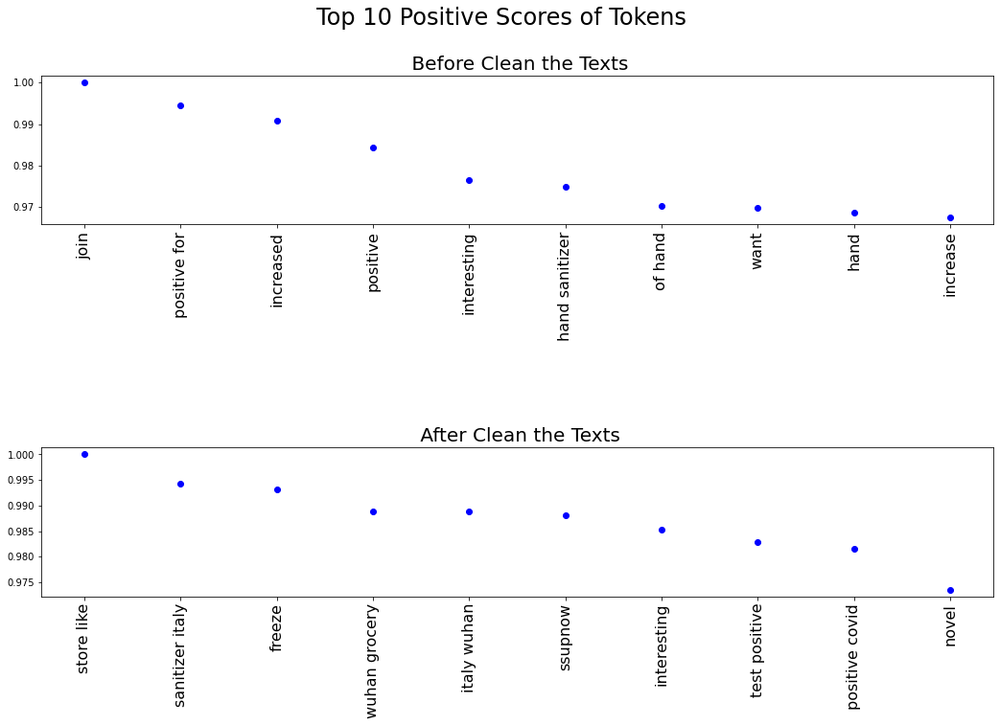

In [29]:
top_n = 10
term_freq_df_ac_Score = term_freq_df_ac_Score.head(10)
term_freq_df_bc_Score = term_freq_df_bc_Score.head(10)
x = range(0, top_n)

fig, ax = plt.subplots(2, 1, figsize = (17.8, 10))

fig.suptitle('Top 10 Positive Scores of Tokens', fontsize= 24)

# Plot x and scores using blue circle markers
ax[0].plot(x, term_freq_df_bc_Score["positive Score"], 'bo')
ax[0].set_title(' Before Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[0].set_xticks(x)
# Set ticks labels for x-axis to be the tokens
x_ticks_labels = term_freq_df_bc_Score.index
ax[0].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Plot x and scores using blue circle markers
ax[1].plot(x, term_freq_df_ac_Score["positive Score"], 'bo')
ax[1].set_title(' After Clean the Texts', fontsize= 20)
# Set number of ticks for x-axis
ax[1].set_xticks(x)
# Set ticks labels for x-axis to be the tokens
x_ticks_labels = term_freq_df_ac_Score.index
ax[1].set_xticklabels(x_ticks_labels, rotation='vertical', fontsize=16)

# Adjust horizontal space
fig.subplots_adjust(hspace=1.5)
plt.show()

**11. Convert the column of the Tweet_texts to a matrix of token counts using CountVectorizer and unigrams and bigrams.**

In [31]:
from sklearn.feature_extraction.text import CountVectorizer

# Initialize the CountVectorizer for unigrams and bigrams
vectorizer = CountVectorizer(stop_words='english', ngram_range=(1, 2), max_features=1000)  # Limit to 1000 features

# Fit and transform the 'Tweet_texts' column
X_count_matrix = vectorizer.fit_transform(train['Tweet_texts_lemmas'])

# Get feature names (tokens)
feature_names = vectorizer.get_feature_names()

# Create a DataFrame with the token counts
df_token_counts = pd.DataFrame(X_count_matrix.toarray(), columns=feature_names)

# Display the DataFrame
print("Matrix of Token Counts (Unigrams and Bigrams):")
print(df_token_counts.head())


Matrix of Token Counts (Unigrams and Bigrams):
   able  absolutely  access  accord  account  act  action  activity  actually  \
0     0           0       0       0        0    0       0         0         0   
1     0           0       0       0        1    0       0         0         0   
2     0           0       0       0        0    0       0         0         0   
3     0           0       0       0        0    0       0         0         0   
4     0           0       0       0        0    0       0         0         0   

   add  ...  write  wrong  year  yes  yesterday  york  york city  york usa  \
0    0  ...      0      0     0    0          0     0          0         0   
1    0  ...      0      0     0    0          0     0          0         0   
2    0  ...      0      0     0    0          0     0          0         0   
3    0  ...      0      0     0    0          0     0          0         0   
4    0  ...      0      0     0    0          0     0          0         0  

In [36]:
print(X_count_matrix)

  (0, 485)	1
  (1, 12)	1
  (1, 875)	1
  (1, 293)	1
  (1, 621)	2
  (1, 568)	2
  (1, 191)	1
  (1, 150)	1
  (1, 473)	1
  (1, 768)	1
  (1, 578)	1
  (1, 779)	1
  (1, 4)	1
  (1, 866)	1
  (1, 698)	1
  (1, 588)	1
  (1, 580)	1
  (2, 779)	1
  (2, 159)	1
  (2, 49)	1
  (2, 262)	1
  (2, 400)	1
  (2, 30)	1
  (2, 177)	1
  (2, 589)	1
  :	:
  (41150, 383)	1
  (41150, 686)	1
  (41150, 900)	1
  (41150, 165)	1
  (41151, 159)	2
  (41151, 177)	1
  (41151, 542)	1
  (41151, 180)	1
  (41151, 367)	1
  (41151, 744)	1
  (41151, 368)	1
  (41151, 160)	1
  (41151, 820)	1
  (41151, 921)	1
  (41151, 991)	1
  (41152, 177)	1
  (41152, 563)	1
  (41152, 26)	1
  (41152, 727)	1
  (41152, 653)	2
  (41152, 507)	1
  (41152, 54)	1
  (41152, 190)	1
  (41152, 495)	1
  (41152, 35)	1


#### 12. Perform the tf-idf analysis on the column of the Tweet_texts using Tfidfvectorizer.

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer
# Initialize the TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(stop_words='english', ngram_range=(1, 2), max_features=1000)

# Fit and transform the 'Tweet_texts' column
X_tfidf_matrix = tfidf_vectorizer.fit_transform(train['Tweet_texts_lemmas'])

# Get feature names (tokens)
feature_names = tfidf_vectorizer.get_feature_names()

# Create a DataFrame with the TF-IDF values
df_tfidf = pd.DataFrame(X_tfidf_matrix.toarray(), columns=feature_names)

# Display the DataFrame
print("Matrix of TF-IDF Values:")
print(df_tfidf.head())

Matrix of TF-IDF Values:
   able  absolutely  access  accord  account  act  action  activity  actually  \
0  0.00        0.00    0.00    0.00     0.00 0.00    0.00      0.00      0.00   
1  0.00        0.00    0.00    0.00     0.26 0.00    0.00      0.00      0.00   
2  0.00        0.00    0.00    0.00     0.00 0.00    0.00      0.00      0.00   
3  0.00        0.00    0.00    0.00     0.00 0.00    0.00      0.00      0.00   
4  0.00        0.00    0.00    0.00     0.00 0.00    0.00      0.00      0.00   

   add  ...  write  wrong  year  yes  yesterday  york  york city  york usa  \
0 0.00  ...   0.00   0.00  0.00 0.00       0.00  0.00       0.00      0.00   
1 0.00  ...   0.00   0.00  0.00 0.00       0.00  0.00       0.00      0.00   
2 0.00  ...   0.00   0.00  0.00 0.00       0.00  0.00       0.00      0.00   
3 0.00  ...   0.00   0.00  0.00 0.00       0.00  0.00       0.00      0.00   
4 0.00  ...   0.00   0.00  0.00 0.00       0.00  0.00       0.00      0.00   

   youtube  zealand

In [35]:
print(X_tfidf_matrix)

  (0, 485)	1.0
  (1, 580)	0.17030926716992204
  (1, 588)	0.17884127856769635
  (1, 698)	0.256373304093815
  (1, 866)	0.15569923176658673
  (1, 4)	0.25521609858203126
  (1, 779)	0.1399918327118551
  (1, 578)	0.13554957668784318
  (1, 768)	0.21942521988703595
  (1, 473)	0.21013617300704152
  (1, 150)	0.21833305392718677
  (1, 191)	0.21769255075109242
  (1, 568)	0.4308650533912849
  (1, 621)	0.48877106310510227
  (1, 293)	0.18578084101221065
  (1, 875)	0.2171669454350298
  (1, 12)	0.2288067174978915
  (2, 185)	0.38347753346301716
  (2, 32)	0.3979210250611647
  (2, 589)	0.3169042701749703
  (2, 177)	0.11972605237602946
  (2, 30)	0.3301733405609138
  (2, 400)	0.34559398706337674
  (2, 262)	0.3847456584198636
  (2, 49)	0.3461415740346289
  :	:
  (41150, 602)	0.30941202273291263
  (41150, 897)	0.3065471237543064
  (41150, 542)	0.18032592111520934
  (41150, 159)	0.13637931992156807
  (41151, 991)	0.44615210402361566
  (41151, 921)	0.4104336194495268
  (41151, 820)	0.3479437783500203
  (41151, 

#### 13. Find the cosine similarity in Tweet_texts between the 200th and 20,000th tweets.

In [37]:
from sklearn.metrics.pairwise import cosine_similarity

# Assuming X_tfidf_matrix is the TF-IDF matrix from the previous example
# You may need to adapt the indices based on your DataFrame
index_200th_tweet = 199  # Python uses 0-based indexing
index_20000th_tweet = 19999

# Extract the TF-IDF vectors for the two tweets
tfidf_200th_tweet = X_tfidf_matrix[index_200th_tweet].reshape(1, -1)
tfidf_20000th_tweet = X_tfidf_matrix[index_20000th_tweet].reshape(1, -1)

# Compute cosine similarity
cosine_sim = cosine_similarity(tfidf_200th_tweet, tfidf_20000th_tweet)

# Display the result
print(f"Cosine Similarity between 200th and 20,000th tweets: {cosine_sim[0][0]}")


Cosine Similarity between 200th and 20,000th tweets: 0.007486921742840305


#### 14. Find the corpus vector equal to the average of all the document vectors, where each document corresponds to a tweet or a row in this dataset.

In [39]:
import numpy as np

corpus_vector = np.mean(X_tfidf_matrix, axis=0)

corpus_vector_dense = corpus_vector

# Display the shape of the corpus vector
print(f"Shape of the Corpus Vector: {corpus_vector.shape}")

# Display the corpus vector (dense representation)
print("Corpus Vector (Dense):")
print(corpus_vector_dense)


Shape of the Corpus Vector: (1, 1000)
Corpus Vector (Dense):
[[0.00287678 0.00119583 0.00238215 0.00147569 0.00118504 0.00223222
  0.00197539 0.00127739 0.00197831 0.0020532  0.0011042  0.00224553
  0.00226744 0.00350337 0.00142098 0.00307022 0.00133206 0.00173127
  0.00145901 0.00115873 0.00217612 0.00145373 0.00219189 0.00175843
  0.00339294 0.0012874  0.00375095 0.00237606 0.00160793 0.00229621
  0.00613961 0.00184133 0.00277004 0.02063643 0.00365565 0.00253128
  0.00170376 0.00138265 0.00131089 0.00154261 0.00139938 0.00244238
  0.00105377 0.00342309 0.00220561 0.00158603 0.00454673 0.00183144
  0.00152184 0.00578922 0.00408429 0.00340681 0.00313234 0.00137923
  0.00397554 0.00216174 0.00131293 0.00490724 0.00199219 0.0019592
  0.0015232  0.00158929 0.00257795 0.00390321 0.00191937 0.00177722
  0.00181761 0.00449348 0.00112894 0.00154284 0.00143038 0.00153119
  0.00122291 0.0015093  0.00239804 0.00220083 0.00147382 0.00269453
  0.0018574  0.00218701 0.00312991 0.00168536 0.00919844

#### 15. Build the first model based on the training dataset using the random forests and pipeline.

In [40]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, classification_report

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    train['Tweet_texts_lemmas'],
    train['Sentiment'],
    test_size=0.2,  # Adjust the test size as needed
    random_state=42
)

# Create a pipeline with TF-IDF vectorization and Random Forests
pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(stop_words='english', ngram_range=(1, 1),max_features=1000 )),
    ('rf', RandomForestClassifier(random_state=42))
])

# Train the model using the pipeline
pipeline.fit(X_train, y_train)

# Make predictions on the test set
y_pred = pipeline.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Display the evaluation metrics
print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(classification_rep)


Accuracy: 0.509780099623375
Classification Report:
                    precision    recall  f1-score   support

Extremely Negative       0.67      0.38      0.48      1089
Extremely Positive       0.65      0.36      0.46      1394
          Negative       0.48      0.47      0.48      1968
           Neutral       0.53      0.71      0.60      1531
          Positive       0.45      0.56      0.50      2249

          accuracy                           0.51      8231
         macro avg       0.55      0.50      0.50      8231
      weighted avg       0.53      0.51      0.50      8231



#### 16. Check the first model on the test dataset. Is it a good model based on the selected evaluation metrics? Please justify your answer.

Based on the F1 scores the model fails to predict the sentiment 50% of the times. especially Negative tweets are being misclassified.

#### 17. Create the second model using pipeline, grid search CV for the hyperparameters for the estimators. (Please see all the potential parameters at Scikit Learn's TfidVectorizerLinks to an external site. and random forestsLinks to an external site..)

In [41]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    train['Tweet_texts_lemmas'],
    train['Sentiment'],
    test_size=0.2,
    random_state=42
)

# Create a pipeline with TF-IDF vectorization and Random Forests
pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(stop_words='english')),
    ('rf', RandomForestClassifier(random_state=42))
])

# Define the hyperparameter grid
param_grid = {
    'tfidf__ngram_range': [(1, 1), (1, 2)],
    'tfidf__max_features': [1000, 5000, 10000], 
    'rf__max_depth': [None, 10, 20, 30], 
}

# Perform grid search with cross-validation
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# Display the best hyperparameters
print("Best Hyperparameters:")
print(grid_search.best_params_)

# Make predictions on the test set using the best model
y_pred = grid_search.predict(X_test)

# Evaluate the model
classification_rep = classification_report(y_test, y_pred)

# Display the evaluation metrics
print("Classification Report:")
print(classification_rep)


Best Hyperparameters:
{'rf__max_depth': None, 'tfidf__max_features': 5000, 'tfidf__ngram_range': (1, 1)}
Classification Report:
                    precision    recall  f1-score   support

Extremely Negative       0.62      0.47      0.54      1089
Extremely Positive       0.61      0.45      0.52      1394
          Negative       0.48      0.44      0.46      1968
           Neutral       0.53      0.69      0.60      1531
          Positive       0.46      0.53      0.49      2249

          accuracy                           0.52      8231
         macro avg       0.54      0.52      0.52      8231
      weighted avg       0.52      0.52      0.51      8231



#### 18. Tune the second model and perform model diagnostics on the test dataset. Is it a good model? Please justify your answer.

Based on the F1 scores the model fails to predict the sentiment 50% of the times. especially Negative tweets are being misclassified.

#### 19. Build the third model using pipeline, grid search CV, hyperparameter for the following classifiers:
Logistic Regression
Support Vector Machine
Random Forest

In [59]:
from sklearn.model_selection import GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    train['Tweet_texts_lemmas'],
    train['Sentiment'],
    test_size=0.2,
    random_state=42
)

# Create a pipeline with TF-IDF vectorization and classifiers
pipeline = Pipeline([
    ('tfidf', TfidfVectorizer(stop_words='english')),
    ('classifier', None)  # This will be replaced by the classifier during grid search
])

# Define the hyperparameter grid for different classifiers
param_grid = [
    {
        'classifier': [LogisticRegression()],
        'classifier__penalty': ['l2'],
        'classifier__C': [ 0.01, 0.1]
    },
    {
        'classifier': [SVC()],
        'classifier__C': [ 1, 10],
        'classifier__kernel': ['linear', 'rbf']
    },
    {
        'classifier': [RandomForestClassifier()],
        'classifier__n_estimators': [100, 200],
        'classifier__max_depth': [10, 20]
    }
]

# Perform grid search with cross-validation
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# Display the best hyperparameters and classifier
print("Best Hyperparameters:")
print(grid_search.best_params_)

# Make predictions on the test set using the best model
y_pred = grid_search.predict(X_test)

# Evaluate the model
classification_rep = classification_report(y_test, y_pred)

# Display the evaluation metrics
print("Classification Report:")
print(classification_rep)


Best Hyperparameters:
{'classifier': SVC(C=1, kernel='linear'), 'classifier__C': 1, 'classifier__kernel': 'linear'}
Classification Report:
                    precision    recall  f1-score   support

Extremely Negative       0.68      0.56      0.62      1089
Extremely Positive       0.70      0.57      0.63      1394
          Negative       0.53      0.56      0.54      1968
           Neutral       0.65      0.66      0.65      1531
          Positive       0.54      0.61      0.57      2249

          accuracy                           0.59      8231
         macro avg       0.62      0.59      0.60      8231
      weighted avg       0.60      0.59      0.60      8231



#### 20. Tune the third model and perform model diagnostics on the test dataset. Is it a good model? Please justify your answer.

Better model compared to previous one. Yet fails to misclassify some classes.

#### 21. Generate the first topic model on Tweet_texts column by setting five topics using LDA method and CountVectorizer.

In [51]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

# Create a CountVectorizer to convert text data to a bag-of-words representation
vectorizer = CountVectorizer(stop_words='english', max_df=0.85, max_features=5000)

# Fit and transform the 'Tweet_texts' column
X_count_matrix = vectorizer.fit_transform(train['Tweet_texts_lemmas'])

# Create an LDA model with five topics
lda_model = LatentDirichletAllocation(n_components=5, random_state=42)

# Fit the LDA model to the CountVectorizer output
lda_topic_matrix = lda_model.fit_transform(X_count_matrix)

#### 22. Plot the top 15 words for each topic for the model above.

In [53]:
# Display the top words for each topic
feature_names = vectorizer.get_feature_names()
n_top_words = 15  # Adjust as needed

for topic_idx, topic in enumerate(lda_model.components_):
    top_words_idx = topic.argsort()[:-n_top_words - 1:-1]
    top_words = [feature_names[i] for i in top_words_idx]
    print(f"Topic #{topic_idx + 1}:", ", ".join(top_words))



Topic #1: covid, food, demand, consumer, coronavirus, supply, pandemic, amp, nan, impact, increase, stock, bank, crisis, market
Topic #2: price, covid, coronavirus, nan, oil, india, low, market, mask, gas, amp, sell, sanitizer, high, fall
Topic #3: coronavirus, covid, supermarket, store, grocery, people, nan, food, panic, buy, toiletpaper, toilet, like, paper, need
Topic #4: store, covid, grocery, supermarket, online, worker, coronavirus, shopping, work, nan, people, home, delivery, amp, shop
Topic #5: covid, coronavirus, consumer, hand, sanitizer, new, amp, nan, help, business, change, pandemic, use, york, time


#### 23. Generate the second topic model on Tweet_texts column by setting five topics using LDA method and TfidfVectorizer.

In [54]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(stop_words='english', max_df=0.85, max_features=5000)

# Fit and transform the 'Tweet_texts' column
X_tfidf_matrix = vectorizer.fit_transform(train['Tweet_texts_lemmas'])

# Create an LDA model with five topics
lda_model = LatentDirichletAllocation(n_components=5, random_state=42)

# Fit the LDA model to the TfidfVectorizer output
lda_topic_matrix = lda_model.fit_transform(X_tfidf_matrix)

#### 24. Plot the top 15 words for each topic for the second model above.

In [56]:
# Display the top words for each topic
feature_names = vectorizer.get_feature_names()
n_top_words = 15  # Adjust as needed

for topic_idx, topic in enumerate(lda_model.components_):
    top_words_idx = topic.argsort()[:-n_top_words - 1:-1]
    top_words = [feature_names[i] for i in top_words_idx]
    print(f"Topic #{topic_idx + 1}:", ", ".join(top_words))


Topic #1: price, covid, demand, food, consumer, coronavirus, pandemic, oil, market, impact, increase, nan, supply, global, new
Topic #2: price, covid, coronavirus, nan, sanitizer, hand, gas, oil, mask, india, trump, low, people, amp, sell
Topic #3: coronavirus, store, grocery, covid, supermarket, toiletpaper, nan, toilet, paper, people, food, panic, buy, like, hand
Topic #4: supermarket, store, worker, covid, grocery, nan, work, coronavirus, people, food, online, shopping, need, amp, delivery
Topic #5: consumer, covid, coronavirus, new, online, business, nan, pandemic, amp, help, scam, change, shopping, retail, check


#### 25. Visualize the second topic model using the dimension reduction method.

In [57]:
import plotly.express as px
from sklearn.manifold import TSNE

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(lda_topic_matrix)

# Add t-SNE components to the DataFrame
train['tsne_x'] = X_tsne[:, 0]
train['tsne_y'] = X_tsne[:, 1]

# Visualize the t-SNE plot
fig = px.scatter(train, x='tsne_x', y='tsne_y', color=train['Sentiment'].astype(str),
                 hover_data=['Tweet_texts'], title='t-SNE Visualization of LDA Topics')

fig.show()